# BASELINE MODEL (DCGAN) IMPLEMENTATION:
This DCGAN Model Code is referred from here: https://www.kaggle.com/code/splcher/starter-anime-face-dataset

Modified/Added the following to the above code:
* Added Custom Data Processing to resize the images for FID Evaluation and store them as processed images.
* Added Custom Image saving Module (with un-normalization) to save the generated Fake images back as Image files.
* Added Code to Save & Load Models to avoid re-training, along with a test to see if the model is loaded correctly.
* Added Code to compute our evaluation metrics to get the baseline performance from the processed images of the input data and the generated fake images.

In [1]:
%matplotlib inline
import time
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
from torchvision.utils import save_image
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
seed = 6969
# seed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", seed)
random.seed(seed)
torch.manual_seed(seed)

Random Seed:  6969


In [ ]:
# Connect Drive
from google.colab import drive
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [2]:
# Root directory for dataset
dataroot = "drive/MyDrive/Colab Datasets/AnimeFacesDataset/Raw/"

# Directory to store generated fake images
fake_image_save_path = 'drive/MyDrive/Colab Results/CSE598_GroupProject/BaselineModel_GAN/'

# Data Normalization Setting
normalize_mean = (0.5, 0.5, 0.5)
normalize_std = (0.5, 0.5, 0.5)

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 50 # Original is 5 on a dataset of 1 million

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

## DATA PROCESSING

In [9]:
# Resize Images to same dimension to facilitate Evaluation
from genericpath import isdir
from PIL import Image
import os, sys

raw_data_path = dataroot + 'images/'
processed_data_path = "drive/MyDrive/Colab Datasets/AnimeFacesDataset/Processed/images/"
raw_images = os.listdir(raw_data_path) # This line intermittently causes failure due to huge number of Files. Retry multiple times and it will eventually pass.
print('Number of Raw Images in Input Data:',len(raw_images))
if not os.path.isdir(processed_data_path):
  os.makedirs(processed_data_path)
processed_images = set(os.listdir(processed_data_path))
print('Number of Pre-processed Images in Input Data:',len(processed_images))
# COMMENT NOTE: Instead of deleting them, we're instead going to skip processing them
# elif len(os.listdir(raw_data_path))!=len(os.listdir(processed_data_path)):
#   # Delete all Processed Files if some are missing
#   for root, dirs, files in os.walk(processed_data_path, topdown=False):
#     for file in files:
#         os.remove(os.path.join(root, file))
#     for dir in dirs:
#         os.rmdir(os.path.join(root, dir))

# If all files already exist, do not run it again
if len(raw_images)!=len(processed_images):
  image_index = 0
  for image in raw_images:
    image_path = os.path.join(raw_data_path, image)
    image_save_path = os.path.join(processed_data_path, image)
    if len(image.split("."))<2 or (image.split(".")[1] not in ["jpg", "png"]) or (image in processed_images):
        continue
    if os.path.exists(image_path):
        try:
          im = Image.open(image_path)
          image_resized = im.resize((image_size,image_size))
          image_resized.save(image_save_path, quality=100)
        except:
          print(f'Failed: {image}')
    if image_index%500==0:
      print(f'Processed {image_index} images')
    image_index+=1
  print('Images Resized and Saved')

Number of Raw Images in Input Data: 63707
Number of Pre-processed Images in Input Data: 37834
Failed: 5841_2003 (1).jpg
Processed 0 images
Processed 500 images
Processed 1000 images
Processed 1500 images
Failed: 55107_2016 (1).jpg
Processed 2000 images
Failed: 51024_2015 (1).jpg
Processed 2500 images
Processed 3000 images
Failed: 49355_2015 (1).jpg
Processed 3500 images
Processed 4000 images
Processed 4500 images
Processed 5000 images
Processed 5500 images
Processed 6000 images
Processed 6500 images
Processed 7000 images
Processed 7500 images
Processed 8000 images
Processed 8500 images
Failed: 42474_2013 (1).jpg
Processed 9000 images
Processed 9500 images
Processed 10000 images
Processed 10500 images
Failed: 38126_2012 (1).jpg
Failed: 39189_2012 (1).jpg
Processed 11000 images
Processed 11500 images
Processed 12000 images
Processed 12500 images
Processed 13000 images
Processed 13500 images
Processed 14000 images
Failed: 30203_2010 (1).jpg
Failed: 29818_2010.jpg
Processed 14500 images
Fa

## DATASET PREPARATION & DATALOADER

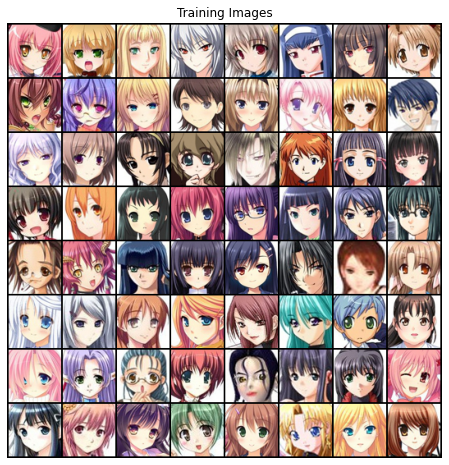

In [ ]:
# Create the dataset [Intermittently fails because of large number of Files. Retry until it succeeds.]
dataroot = 'drive/MyDrive/Colab Datasets/AnimeFacesDataset/Processed/' # TEMP
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize(normalize_mean, normalize_std),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8, 8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

## UTILITY FUNCTIONS (for MODEL TRAINING)

In [ ]:
# UnNormalize Class allows us to reverse the data processing, get the original image tensor back to write to a file

class UnNormalize(object):
    def __init__(self, mean, std):
        self.mean = mean
        self.std = std

    def __call__(self, tensor):
        """
        Args:
            tensor (Tensor): Tensor image of size (C, H, W) to be normalized.
        Returns:
            Tensor: Normalized image.
        """
        for t, m, s in zip(tensor, self.mean, self.std):
            t.mul_(s).add_(m)
            # The normalize code -> t.sub_(m).div_(s)
        return tensor

unorm = UnNormalize(mean=normalize_mean, std=normalize_std)

In [ ]:
# Custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

## GAN MODEL DEFINITION

In [ ]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [ ]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


## MODEL TRAINING

In [ ]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1
fake_label = 0

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [ ]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
total_train_start_time = time.time()
# For each epoch
for epoch in range(num_epochs):
  epoch_start_time = time.time()
  # For each batch in the dataloader
  for i, data in enumerate(dataloader, 0): # First Epoch DataLoader takes long, as it caches the entire dataset
    ############################
    # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
    ###########################
    ## Train with all-real batch
    netD.zero_grad()
    # Format batch
    real_cpu = data[0].to(device)
    b_size = real_cpu.size(0)
    label = torch.full((b_size,), real_label, device=device, dtype=torch.float)
    # Forward pass real batch through D
    output = netD(real_cpu).view(-1)
    # Calculate loss on all-real batch
    errD_real = criterion(output, label)
    # Calculate gradients for D in backward pass
    errD_real.backward()
    D_x = output.mean().item()

    ## Train with all-fake batch
    # Generate batch of latent vectors
    noise = torch.randn(b_size, nz, 1, 1, device=device)
    # Generate fake image batch with G
    fake = netG(noise)
    label.fill_(fake_label)
    # Classify all fake batch with D
    output = netD(fake.detach()).view(-1)
    # Calculate D's loss on the all-fake batch
    errD_fake = criterion(output, label)
    # Calculate the gradients for this batch
    errD_fake.backward()
    D_G_z1 = output.mean().item()
    # Add the gradients from the all-real and all-fake batches
    errD = errD_real + errD_fake
    # Update D
    optimizerD.step()

    ############################
    # (2) Update G network: maximize log(D(G(z)))
    ###########################
    netG.zero_grad()
    label.fill_(real_label)  # fake labels are real for generator cost
    # Since we just updated D, perform another forward pass of all-fake batch through D
    output = netD(fake).view(-1)
    # Calculate G's loss based on this output
    errG = criterion(output, label)
    # Calculate gradients for G
    errG.backward()
    D_G_z2 = output.mean().item()
    # Update G
    optimizerG.step()

    # Output training stats
    if i % 1000 == 0:
        print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
              % (epoch, num_epochs, i, len(dataloader),
                  errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

    # Save Losses for plotting later
    G_losses.append(errG.item())
    D_losses.append(errD.item())

    # Check how the generator is doing by saving G's output on fixed_noise
    if (iters % 250 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
        with torch.no_grad():
            fake = netG(fixed_noise).detach().cpu()
        img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
    iters += 1
  print(f'Epoch {epoch} took: {time.time()-epoch_start_time} seconds\n')

print(f'\n\n Model Training for {num_epochs} epochs took: {time.time()-total_train_start_time} seconds')

Starting Training Loop...
[0/50][0/119]	Loss_D: 1.9048	Loss_G: 5.9576	D(x): 0.6062	D(G(z)): 0.6793 / 0.0045
Epoch 0 took: 25.143771409988403 seconds

[1/50][0/119]	Loss_D: 0.2115	Loss_G: 4.6754	D(x): 0.9463	D(G(z)): 0.1166 / 0.0184
Epoch 1 took: 23.950100421905518 seconds

[2/50][0/119]	Loss_D: 1.5208	Loss_G: 13.9035	D(x): 0.9573	D(G(z)): 0.6899 / 0.0000
Epoch 2 took: 23.03503727912903 seconds

[3/50][0/119]	Loss_D: 0.2021	Loss_G: 3.2337	D(x): 0.9160	D(G(z)): 0.0718 / 0.0673
Epoch 3 took: 23.282655477523804 seconds

[4/50][0/119]	Loss_D: 0.5128	Loss_G: 5.3640	D(x): 0.8210	D(G(z)): 0.2205 / 0.0078
Epoch 4 took: 23.20273733139038 seconds

[5/50][0/119]	Loss_D: 0.3291	Loss_G: 5.4789	D(x): 0.9077	D(G(z)): 0.1583 / 0.0081
Epoch 5 took: 23.040964365005493 seconds

[6/50][0/119]	Loss_D: 1.1870	Loss_G: 10.3312	D(x): 0.9837	D(G(z)): 0.5918 / 0.0002
Epoch 6 took: 22.946868181228638 seconds

[7/50][0/119]	Loss_D: 0.8333	Loss_G: 9.3966	D(x): 0.8815	D(G(z)): 0.4276 / 0.0002
Epoch 7 took: 23.3705379

## SAVE & LOAD MODEL

In [ ]:
# Save both Discriminator & Generator Model
discriminator_model_path = 'drive/MyDrive/Colab Models/CSE598_GroupProject_BaselineModel_GAN/discriminator.pt'
torch.save(netD, discriminator_model_path)
generator_model_path = 'drive/MyDrive/Colab Models/CSE598_GroupProject_BaselineModel_GAN/generator.pt'
torch.save(netG, generator_model_path)

## GENERATE IMAGES (MODEL INFERENCE & VISUALIZATION)

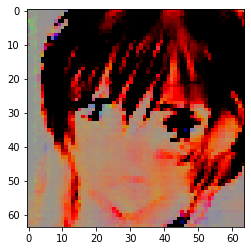

In [ ]:
# Test the Loaded Model performance by generating a Fake Image
loaded_generator_model = torch.load(generator_model_path)
fake = torch.nn.functional.normalize(loaded_generator_model(fixed_noise).detach().cpu())
# plt.imshow(np.transpose(fake[0],(1,2,0)))
plt.imshow(np.transpose(unorm(fake[0]),(1,2,0)))

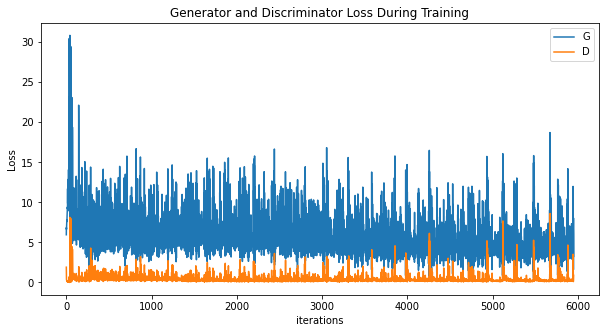

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

torch.Size([3, 530, 530])


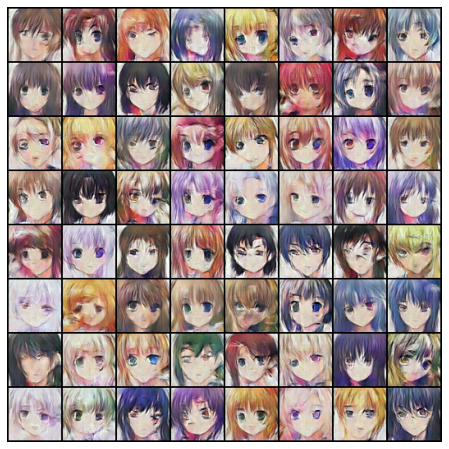

In [ ]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

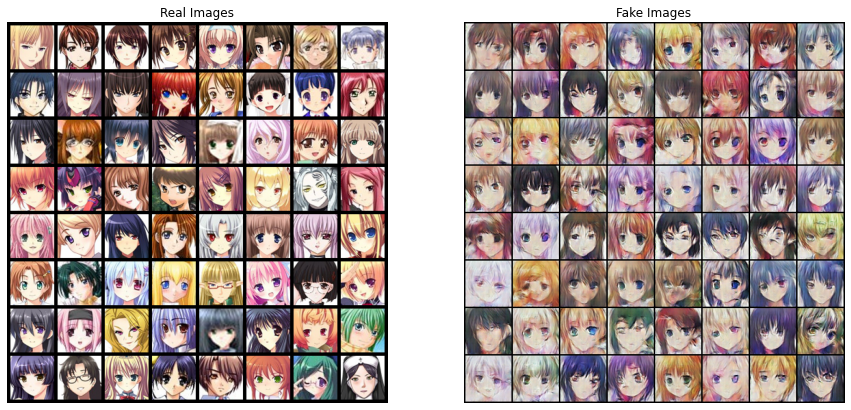

In [ ]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

## STORE GENERATED IMAGES (for EVALUATION & RESULTS)

In [ ]:
# Store the Fake Images for Evaluating with Real Images
import shutil

if os.path.isdir(fake_image_save_path):
  shutil.rmtree(fake_image_save_path)
os.makedirs(fake_image_save_path)

fake_images = fake # img_list[-1]
for i in range(len(fake_images)):
  save_image(unorm(fake_images[i]), fake_image_save_path+f'fake_image_{i}.jpeg')

## MODEL EVALUATION

In [ ]:
# Evaluating Fake & Real Images
!pip install pytorch-fid
# !python -m pytorch_fid "drive/MyDrive/Colab Datasets/AnimeFacesDataset/" "drive/MyDrive/Colab Datasets/AnimeFacesDataset/"
print('\n\nComputing the FID Score for the Model:')
!python -m pytorch_fid 'drive/MyDrive/Colab Datasets/AnimeFacesDataset/Processed/images/' 'drive/MyDrive/Colab Results/CSE598_GroupProject/BaselineModel_GAN/'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Computing the FID Score for the Model:
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
100% 303/303 [01:10<00:00,  4.30it/s]
100% 2/2 [00:00<00:00,  3.53it/s]
FID:  190.3023208928671
